#Deep Learning Final Project: Generating New Art from Old

Importing all the necessary libraries.

In [1]:
import IPython.display as display
import PIL.Image
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf
import functools

Setting global constants that will be used throughout the code.

In [2]:
CHANNELS = 3
MAXSIZE = 512
DIM = 224

Defining the functions that will be used to load the inputted images in the proper format and size and display them.

In [3]:
def getimages(t):
  newimage = tf.image.convert_image_dtype(tf.image.decode_image(tf.io.read_file(t), channels=CHANNELS), tf.float32)
  tempshape = tf.shape(newimage)[:-1]
  size = tf.cast(tempshape, tf.float32)
  resized = tf.cast(size * (MAXSIZE / max(size)), tf.int32)
  newimage = tf.image.resize(newimage, resized)
  return newimage[tf.newaxis, :]

In [4]:
def showimages(t):
  length = len(t.shape)
  if length > CHANNELS:
    t = tf.squeeze(t, axis=0)
  plt.imshow(t)

Retrieving and displaying the image that will be used for the input for style.



In [5]:
imagepath1 = 'https://i.imgur.com/VdNvbB9.jpg/waterlily.jpg'
s1 = tf.keras.utils.get_file('waterlily.jpg', imagepath1)
#imagepath1 = 'https://i.imgur.com/zXWmK37.jpg/baroque.jpg'
#s1 = tf.keras.utils.get_file('baroque.jpg', imagepath1)

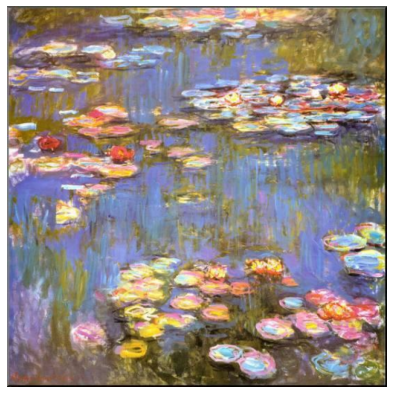

In [6]:
inputstyle = getimages(s1)
plt.figure(figsize=(7, 7))
plt.axis('off')
showimages(inputstyle)

Retrieving and displaying the image that will be used for the input for content.

In [7]:
imagepath2 = 'https://i.imgur.com/Ep5xmfO.jpg/girlflower.jpg'
c1 = tf.keras.utils.get_file('girlflower.jpg', imagepath2)

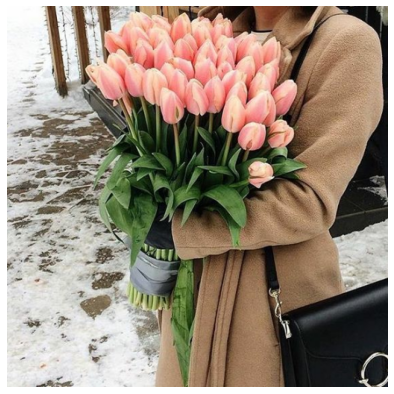

In [8]:
inputcontent = getimages(c1)
plt.figure(figsize=(7, 7))
plt.axis('off')
showimages(inputcontent)

Loading the VGG-19 model from the TensorFlow Keras library using it's pretrained weights and excluding the classification part of the model.

In [9]:
generatormodel = tf.keras.applications.VGG19(include_top=False, weights='imagenet')
generatormodel.summary()

Model: "vgg19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, None, None, 3)]   0         
                                                                 
 block1_conv1 (Conv2D)       (None, None, None, 64)    1792      
                                                                 
 block1_conv2 (Conv2D)       (None, None, None, 64)    36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, None, None, 64)    0         
                                                                 
 block2_conv1 (Conv2D)       (None, None, None, 128)   73856     
                                                                 
 block2_conv2 (Conv2D)       (None, None, None, 128)   147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, None, None, 128)   0     

Creating a VGG-19 model and returns the outputs for our chosen intermediate layers.

In [10]:
def modellayers(t):
  generatormodel = tf.keras.applications.VGG19(include_top=False, weights='imagenet')
  generatormodel.trainable = False
  values = []
  for i in t:
    temp = generatormodel.get_layer(i).output
    #print(temp)
    values.append(temp)
  return tf.keras.Model([generatormodel.input], values)

Choosing the first convolutional layer of each of the blocks to get the style information from.

In [11]:
slayers = ['block1_conv1', 'block2_conv1', 'block3_conv1', 'block4_conv1', 'block5_conv1']

Choosing the second convolutional layer of the fifth block to get the content information from.

In [12]:
clayers = ['block5_conv2'] 

Calculating the gram matrix.

In [13]:
def calculategram(t):
  gramcalc = 'abcd,abce->ade'
  value = tf.linalg.einsum(gramcalc, t, t)
  #print(value)
  temp = tf.shape(t)[1] * tf.shape(t)[2]
  pixels = tf.cast(temp, tf.float32)
  gramvalue = value/(pixels)
  return gramvalue

Model that extracts the features for style and content in tensor form.

In [14]:
class extractfeatures(tf.keras.models.Model):
  def __init__(self, slayers, clayers):
    super(extractfeatures, self).__init__()
    totallayers = slayers + clayers
    self.generatormodel = modellayers(totallayers)
    self.generatormodel.trainable = False
    self.clayers = clayers
    self.slayers = slayers
    self.stylelength = len(slayers)

  def call(self, x):
    size = 255.0
    values = self.generatormodel(tf.keras.applications.vgg19.preprocess_input(x * size))
    
    cvalues = values[self.stylelength:]
    cdict = {cn: value for cn, value in zip(self.clayers, cvalues)}

    svalues = values[:self.stylelength]
    svalues2 = []
    for i in svalues:
      svalues2.append(calculategram(i))
    sdict = {sn: value for sn, value in zip(self.slayers, svalues2)}

    csdict = {'c': cdict, 's': sdict}
    return csdict

Setting all the hyperparameters.

In [15]:
alpha = 0.01
beta = 10000
var = 30
lr = 0.02
b = 0.99
e = 0.1

Extracting the features for content and style.

In [16]:
getfeatures = extractfeatures(slayers, clayers)
cfeatures = getfeatures(inputcontent)['c']
sfeatures = getfeatures(inputstyle)['s']

Defining the function that creates a tensor from the inputted image.

In [17]:
def createtensor(t):
  size = 255
  channel = 4
  t = t * size
  t = np.array(t, dtype=np.uint8)
  check = np.ndim(t)
  #print(check)
  if check >= channel:
    t = t[0]
  im = PIL.Image.fromarray(t)
  return im

Setting Adam optimizer.

In [18]:
adam = tf.optimizers.Adam(learning_rate=lr, beta_1=b, epsilon=e)

Creating training function and training loop and calculating loss.

In [19]:
@tf.function()
def training(t):
  with tf.GradientTape() as tape:
    values = getfeatures(t)
    intermediatevals = getfeatures(t)
    
    sloss = []
    for i in intermediatevals['s'].keys():
      sloss.append(tf.reduce_mean((intermediatevals['s'][i]-sfeatures[i])*(intermediatevals['s'][i]-sfeatures[i])))
    
    closs = []
    for i in intermediatevals['c'].keys():
      closs.append(tf.reduce_mean((intermediatevals['c'][i]-cfeatures[i])*(intermediatevals['c'][i]-cfeatures[i])))

    sloss = tf.add_n(sloss)
    closs = tf.add_n(closs)
    sloss = sloss * (alpha / 5)
    closs = closs * (beta / 1)
    total = sloss + closs

  adam.apply_gradients([(tape.gradient(total, t), t)])
  t.assign(tf.clip_by_value(t, clip_value_min=0.0, clip_value_max=1.0))

In [20]:
def trainingloop():
  epochs = 1001
  for epoch in range(epochs):
    training(inputcontent2)
    if epoch % 100 == 0:
      display.display(createtensor(inputcontent2))
      print('EPOCH ', epoch)

Training using the inputted content and style images.

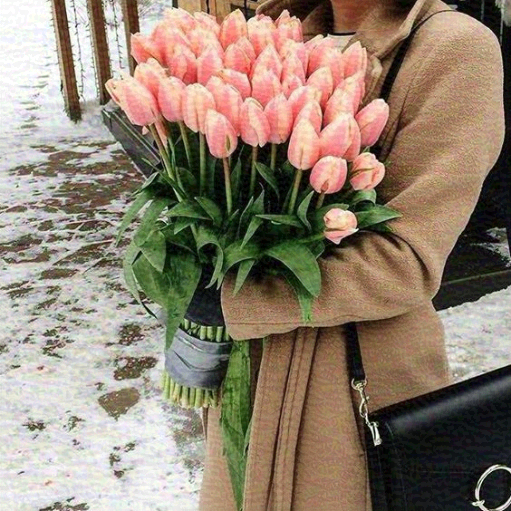

EPOCH  0


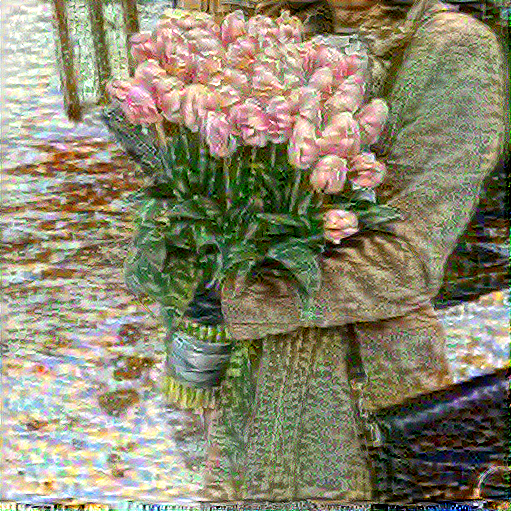

EPOCH  100


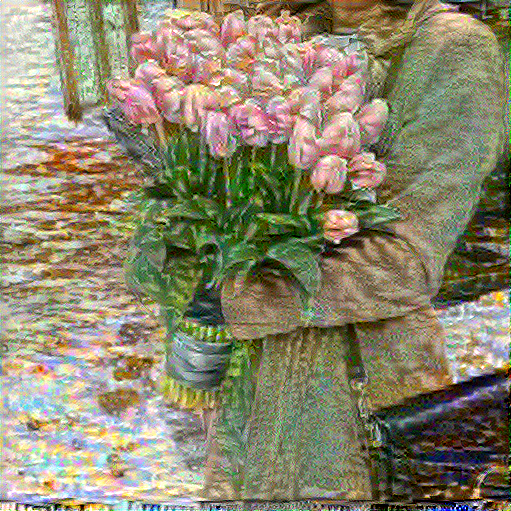

EPOCH  200


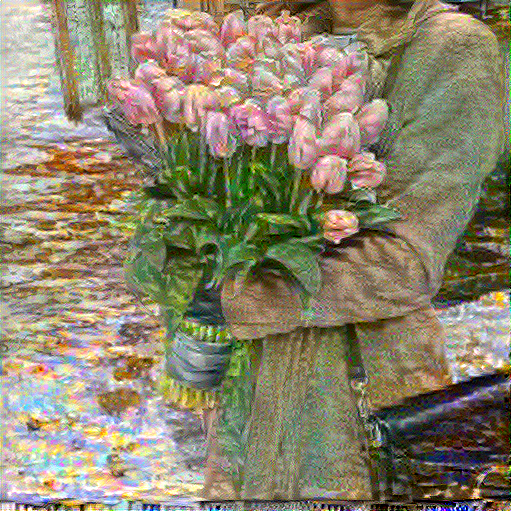

EPOCH  300


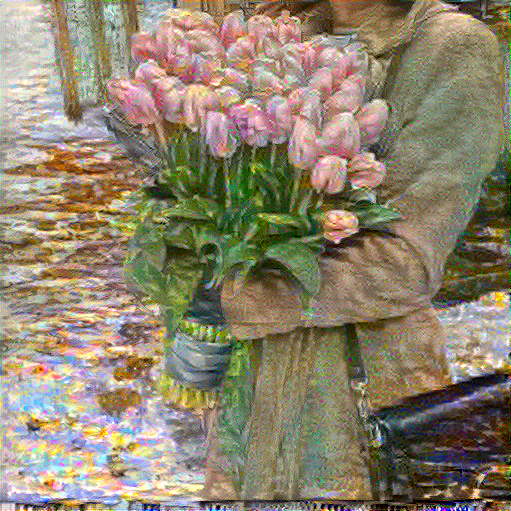

EPOCH  400


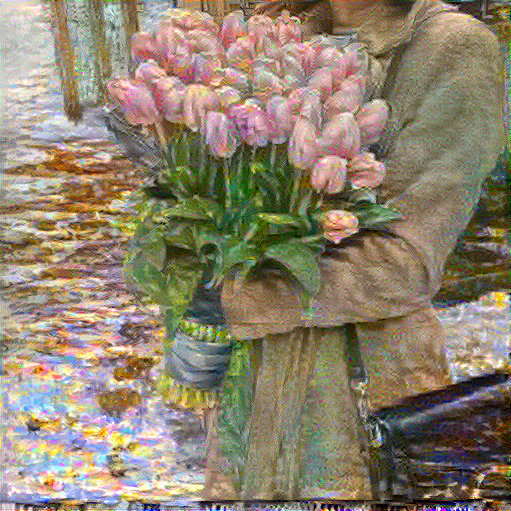

EPOCH  500


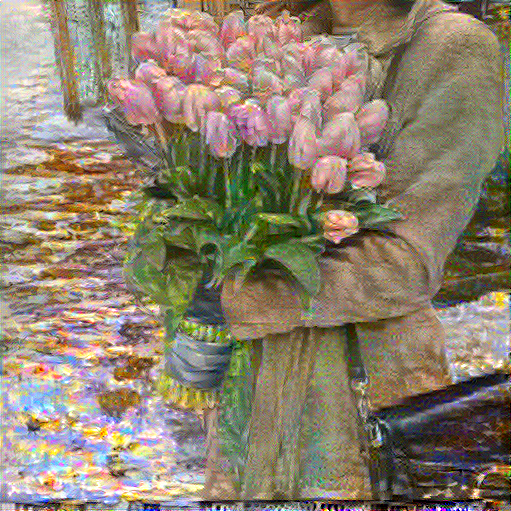

EPOCH  600


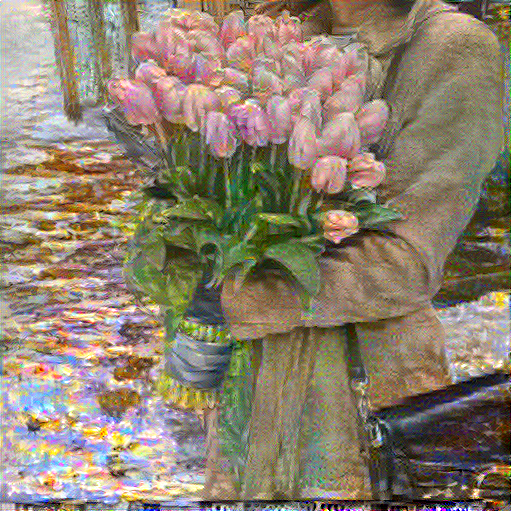

EPOCH  700


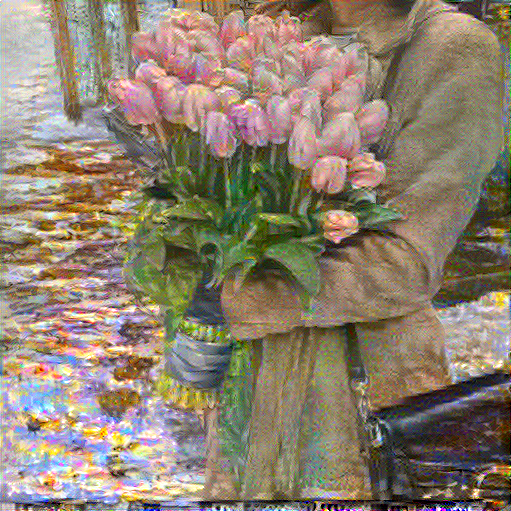

EPOCH  800


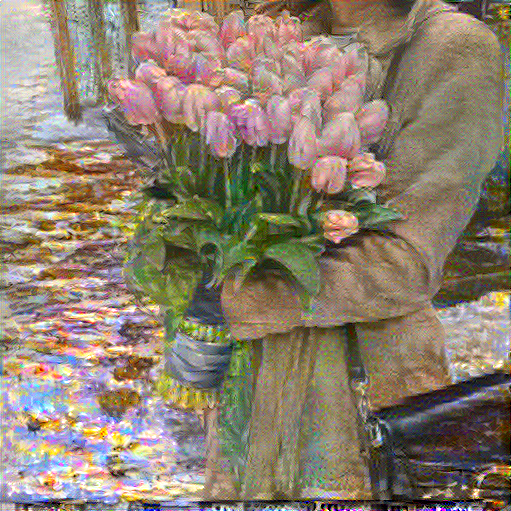

EPOCH  900


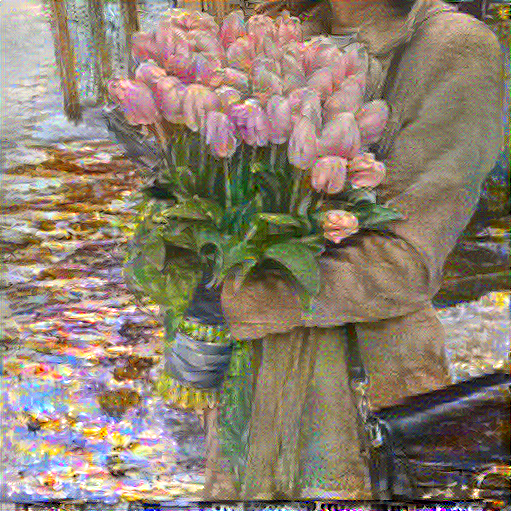

EPOCH  1000


In [21]:
inputcontent2 = tf.Variable(inputcontent)
trainingloop()

Calculating total variation loss.

In [22]:
def varloss(t):
  horizchange = t[:, :, 1:, :] - t[:, :, :-1, :]
  vertchange = t[:, 1:, :, :] - t[:, :-1, :, :]
  reducedx = tf.reduce_sum(tf.abs(horizchange))
  reducedy = tf.reduce_sum(tf.abs(vertchange))
  totalloss = reducedx + reducedy
  return totalloss

New training function that also minimizes total variation loss.

In [23]:
@tf.function()
def training(t):
  with tf.GradientTape() as tape:
    values = getfeatures(t)

    sloss = []
    for i in values['s'].keys():
      sloss.append(tf.reduce_mean((values['s'][i]-sfeatures[i])*(values['s'][i]-sfeatures[i])))
    
    closs = []
    for i in values['c'].keys():
      closs.append(tf.reduce_mean((values['c'][i]-cfeatures[i])*(values['c'][i]-cfeatures[i])))

    sloss = tf.add_n(sloss)
    closs = tf.add_n(closs)
    sloss = sloss * (alpha / 5)
    closs = closs * (beta / 1)
    total = sloss + closs

    weightedloss = var * tf.image.total_variation(t)
    intermediatevals = total + weightedloss

  adam.apply_gradients([(tape.gradient(intermediatevals, t), t)])
  t.assign(tf.clip_by_value(t, clip_value_min=0.0, clip_value_max=1.0))

Training using the inputted content and style images.

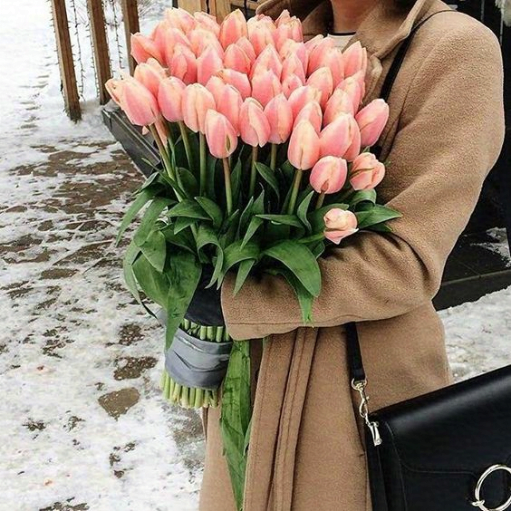

EPOCH  0


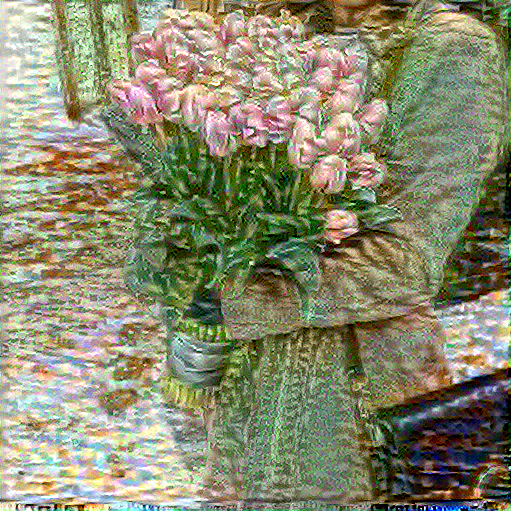

EPOCH  100


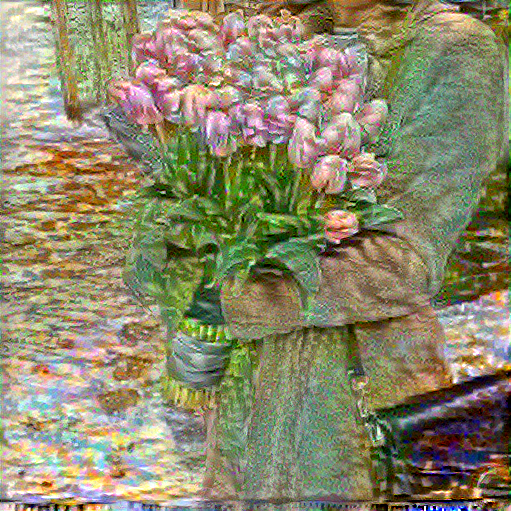

EPOCH  200


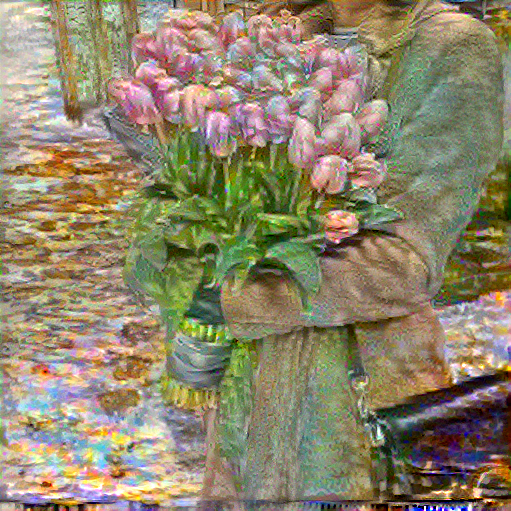

EPOCH  300


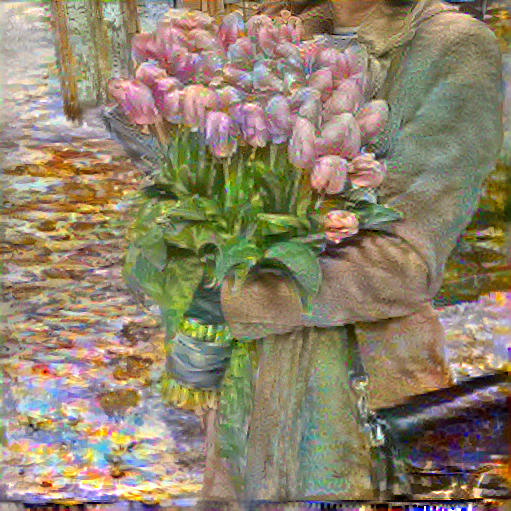

EPOCH  400


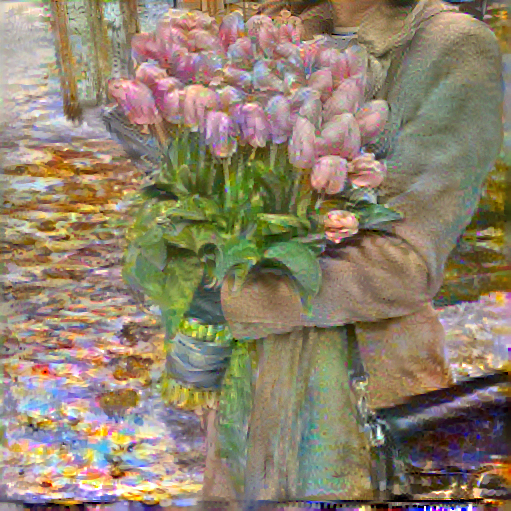

EPOCH  500


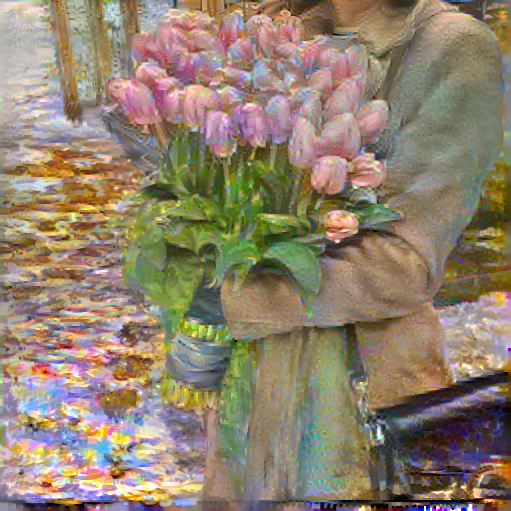

EPOCH  600


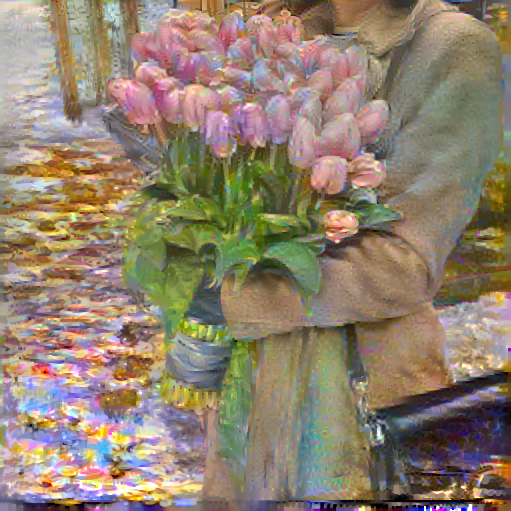

EPOCH  700


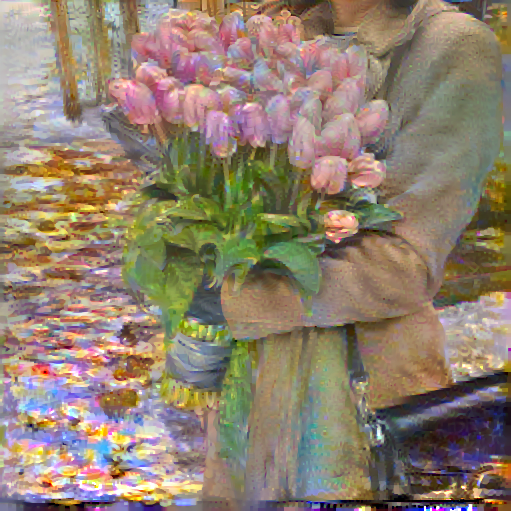

EPOCH  800


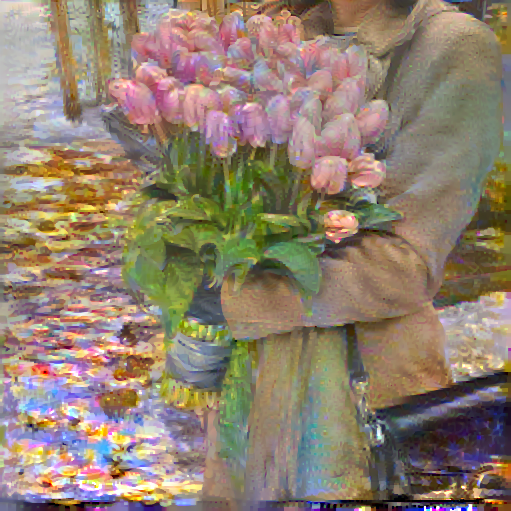

EPOCH  900


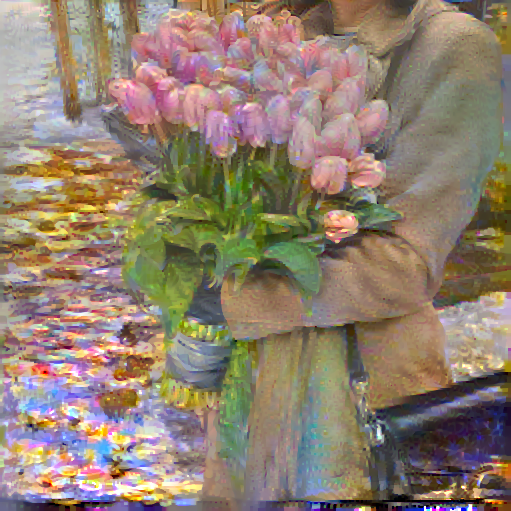

EPOCH  1000


In [24]:
inputcontent2 = tf.Variable(inputcontent)
trainingloop()

Using previously generated image as the content image with a different style image.

In [25]:
imagepath3 = 'https://i.imgur.com/9kkhR3G.jpg/baroque.jpg'
s3 = tf.keras.utils.get_file('baroque.jpg', imagepath3)

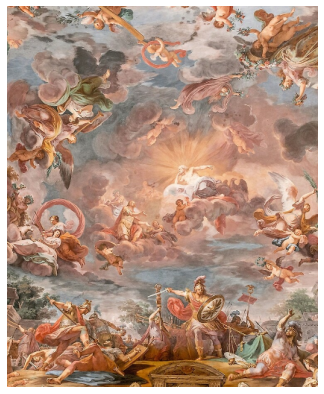

In [26]:
inputstyle = getimages(s3)
plt.figure(figsize=(7, 7))
plt.axis('off')
showimages(inputstyle)

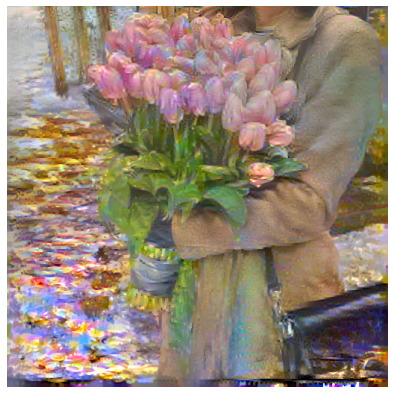

In [27]:
inputcontent = inputcontent2
plt.figure(figsize=(7, 7))
plt.axis('off')
showimages(inputcontent)

In [28]:
getfeatures = extractfeatures(slayers, clayers)
cfeatures = getfeatures(inputcontent)['c']
sfeatures = getfeatures(inputstyle)['s']

In [29]:
@tf.function()
def training2(t):
  with tf.GradientTape() as tape:
    values = getfeatures(t)
    intermediatevals = getfeatures(t)

    sloss = []
    for i in intermediatevals['s'].keys():
      sloss.append(tf.reduce_mean((intermediatevals['s'][i]-sfeatures[i])*(intermediatevals['s'][i]-sfeatures[i])))
    
    closs = []
    for i in intermediatevals['c'].keys():
      closs.append(tf.reduce_mean((intermediatevals['c'][i]-cfeatures[i])*(intermediatevals['c'][i]-cfeatures[i])))

    sloss = tf.add_n(sloss)
    closs = tf.add_n(closs)
    sloss = sloss * (alpha / 5)
    closs = closs * (beta / 1)
    total = sloss + closs

  adam.apply_gradients([(tape.gradient(total, t), t)])
  t.assign(tf.clip_by_value(t, clip_value_min=0.0, clip_value_max=1.0))

In [30]:
def trainingloop2():
  epochs = 1001
  for epoch in range(epochs):
    training2(inputcontent2)
    if epoch % 100 == 0:
      display.display(createtensor(inputcontent2))
      print('EPOCH ', epoch)

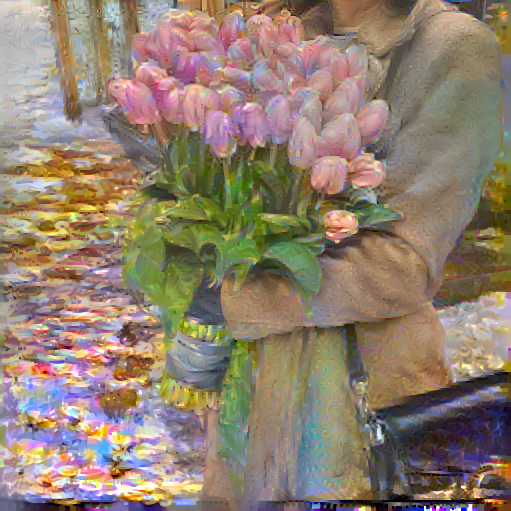

EPOCH  0


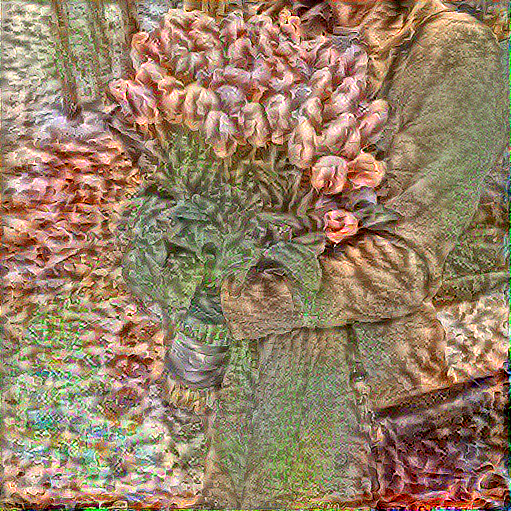

EPOCH  100


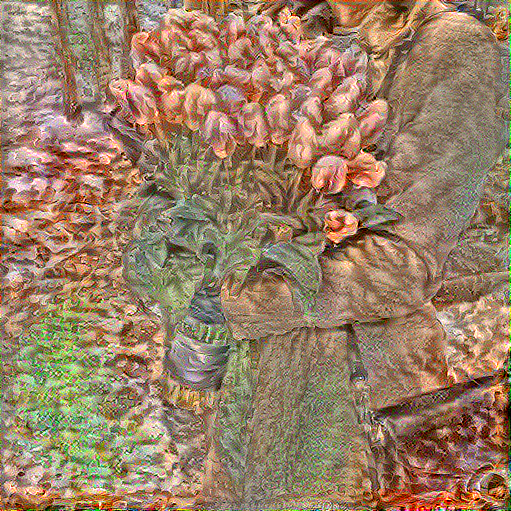

EPOCH  200


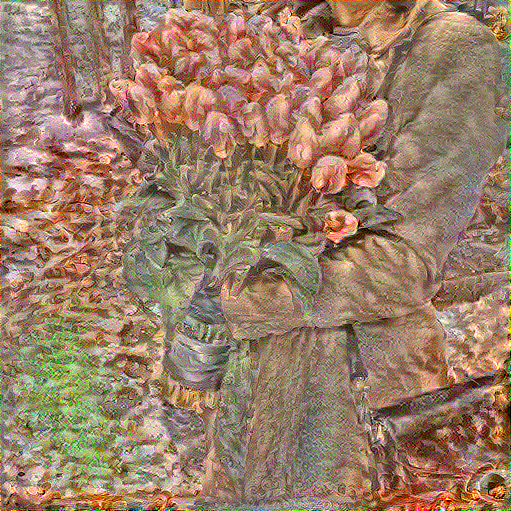

EPOCH  300


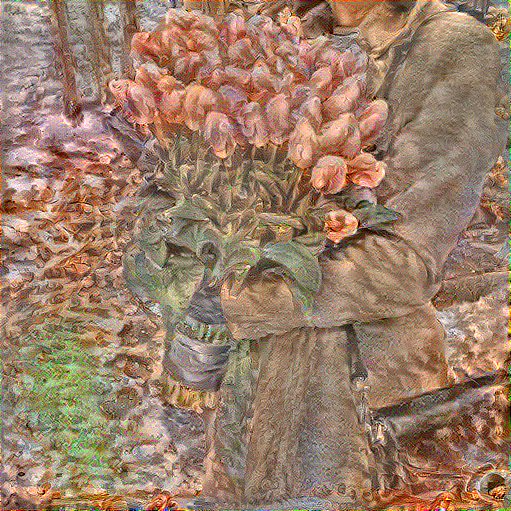

EPOCH  400


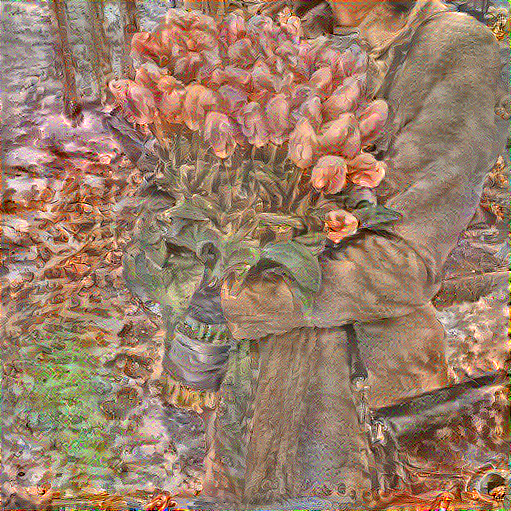

EPOCH  500


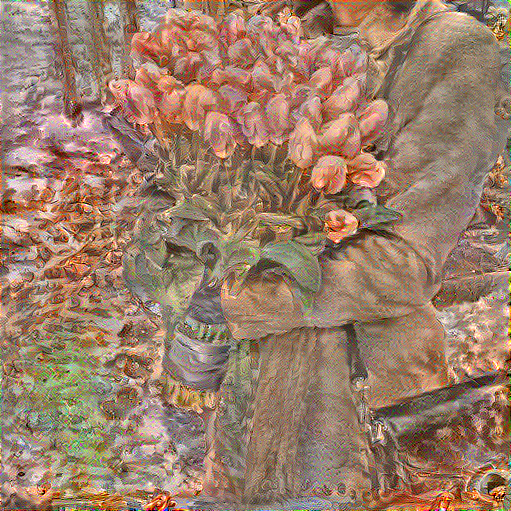

EPOCH  600


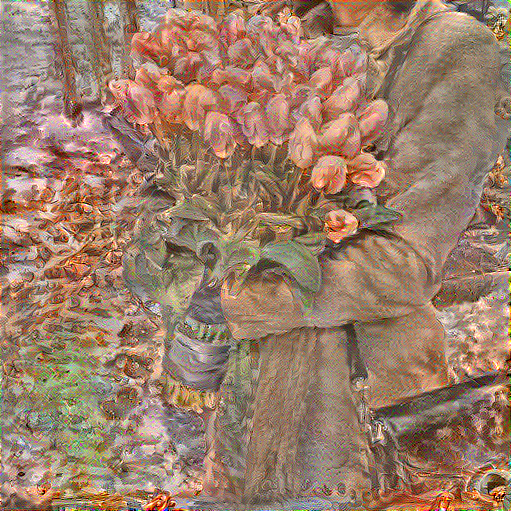

EPOCH  700


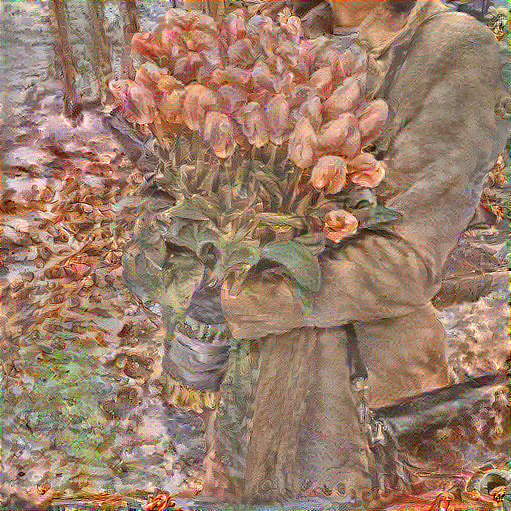

EPOCH  800


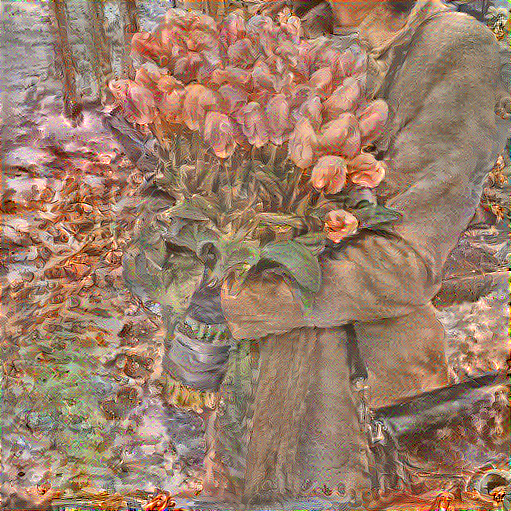

EPOCH  900


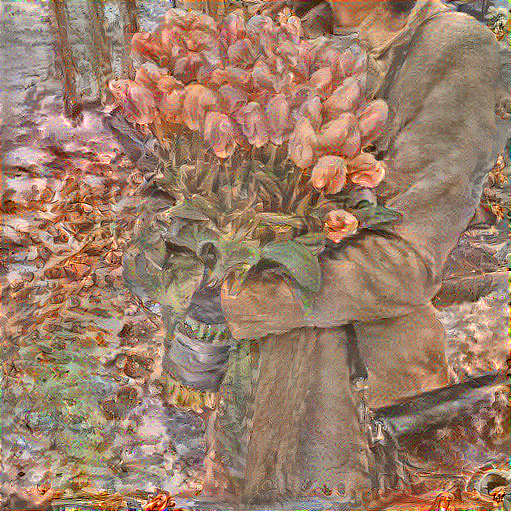

EPOCH  1000


In [31]:
inputcontent2 = tf.Variable(inputcontent)
trainingloop2()